# CryoEM Filament Analysis

This notebook processes 2D cryoEM maps to:
- Detect filaments in the images
- Analyze helical parameters using Fourier transforms
- Segment head/tail regions based on Fourier reflections

---

## 1. Import Libraries

In [1]:
import numpy as np
import mrcfile
from scipy import ndimage
from scipy.fft import fft2, ifft2, fftshift, ifftshift
from scipy.signal import find_peaks
import matplotlib.pyplot as plt
from skimage import morphology, filters
from skimage.measure import label, regionprops

# Set up matplotlib for inline display
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['figure.dpi'] = 100

## 2. Define the FilamentAnalyzer Class

In [2]:
class FilamentAnalyzer:
    def __init__(self, mrc_path, helical_rise=4.7, pixel_size=1.0):
        """
        Initialize the filament analyzer
        
        Args:
            mrc_path: Path to the .mrc or .mrcs file
            helical_rise: Expected helical rise in Angstroms
            pixel_size: Pixel size in Angstroms/pixel
        """
        self.mrc_path = mrc_path
        self.helical_rise = helical_rise
        self.pixel_size = pixel_size
        self.data = None
        self.filtered_data = None
        self.mask = None
        self.fourier_map = None
        
    def load_mrc(self):
        """Load the MRC/MRCS file"""
        try:
            print(f"Loading MRC file: {self.mrc_path}")
            with mrcfile.open(self.mrc_path, mode='r') as mrc:
                self.data = mrc.data.copy()
                if len(self.data.shape) == 3:
                    self.data = self.data[0]
                self.data = self.data.astype(np.float32)
                print(f"Data shape: {self.data.shape}")
                print(f"Data range: [{self.data.min():.3f}, {self.data.max():.3f}]")
            return self.data
        except FileNotFoundError:
            raise FileNotFoundError(f"MRC file not found: {self.mrc_path}")
        except Exception as e:
            raise RuntimeError(f"Error loading MRC file: {str(e)}")
    
    def apply_low_pass_filter(self, sigma=30):
        """Apply low-pass filter to smooth and enhance filament-like features"""
        print(f"Applying low-pass filter (sigma={sigma})...")
        
        # Gaussian low-pass filter
        low_pass = ndimage.gaussian_filter(self.data, sigma=sigma)
        
        # High-pass = original - low-pass
        self.filtered_data = low_pass
        
        # Normalize
        self.filtered_data = (self.filtered_data - self.filtered_data.mean()) / self.filtered_data.std()
        
        return self.filtered_data
    
    def detect_filaments(self, threshold_factor=5.0, min_size=100, dark_noise_threshold=None):
        """
        Detect filament-like densities and create mask (for DARK filaments)
        
        Args:
            threshold_factor: Threshold as multiple of std dev for filament detection
            min_size: Minimum size of filament regions in pixels
            dark_noise_threshold: Optional threshold to exclude very dark noise (e.g., 6.0, 7.0)
                                 If None, uses threshold_factor + 2.0 as cutoff
        """
        print("Detecting filaments...")
        
        # Step 1: Set threshold to exclude extremely dark noise/outliers
        if dark_noise_threshold is None:
            # By default, exclude pixels darker than threshold_factor + 2.0 std
            dark_noise_threshold = threshold_factor + 2.0
        
        dark_cutoff = self.filtered_data.mean() - dark_noise_threshold * self.filtered_data.std()
        print(f"  Excluding very dark noise below: {dark_cutoff:.4f}")
        
        # Step 2: Threshold the filtered data (for DARK filaments)
        threshold = self.filtered_data.mean() - threshold_factor * self.filtered_data.std()
        print(f"  Filament threshold: {threshold:.4f}")
        
        # Create binary mask: dark enough to be filament, but not too dark (noise)
        binary = (self.filtered_data < threshold) & (self.filtered_data > dark_cutoff)
        
        # Clean up with morphological operations
        binary = morphology.remove_small_objects(binary, min_size=min_size)
        binary = morphology.binary_closing(binary, morphology.disk(3))
        
        # Optional: Remove small holes inside filaments
        binary = morphology.remove_small_holes(binary, area_threshold=50)
        
        # Create mask (1 where filaments are, 0 elsewhere)
        self.mask = binary.astype(float)
        
        print(f"Detected {np.sum(self.mask > 0)} filament pixels")
        
        return self.mask
    
    def compute_fourier_transform(self, use_mask=False):
        """
        Compute Fourier transform of unmasked regions
        
        Args:
            use_mask: If True, mask out filament regions before FFT
        """
        print("Computing Fourier transform...")
        
        if use_mask and self.mask is not None:
            # Apply inverse mask (analyze background)
            masked_data = self.data * (1 - self.mask)
        else:
            masked_data = self.data
        
        # Compute 2D FFT
        fft_data = fft2(masked_data)
        self.fourier_map = fftshift(fft_data)
        
        # Compute power spectrum for visualization
        power_spectrum = np.abs(self.fourier_map) ** 2
        power_spectrum = np.log10(power_spectrum + 1)  # Log scale
        
        return self.fourier_map, power_spectrum
    
    def find_helical_reflection(self, search_window=5):
        """
        Find reflection corresponding to helical rise
        
        Args:
            search_window: Search window size in pixels around expected position
        """
        print(f"Searching for helical reflection at {self.helical_rise} Å...")
        
        # Calculate expected spatial frequency
        # Frequency = 1 / helical_rise (in 1/Angstrom)
        # Convert to pixels: freq_pixels = freq_real * (image_size * pixel_size)
        image_size = self.data.shape[0]
        expected_freq = 1.0 / self.helical_rise  # 1/Angstrom
        freq_in_pixels = expected_freq * image_size * self.pixel_size
        
        print(f"Expected frequency: {expected_freq:.4f} 1/Å")
        print(f"Expected pixel position: {freq_in_pixels:.2f} pixels from center")
        
        # Get power spectrum
        power = np.abs(self.fourier_map) ** 2
        
        # Search in a window around expected position
        center = np.array(power.shape) // 2
        
        # Create radial profile
        y, x = np.ogrid[:power.shape[0], :power.shape[1]]
        r = np.sqrt((x - center[1])**2 + (y - center[0])**2)
        
        # Find pixels near expected frequency
        mask = (r >= freq_in_pixels - search_window) & (r <= freq_in_pixels + search_window)
        
        if np.sum(mask) == 0:
            print("Warning: No pixels found in search window")
            return None
        
        # Find maximum in this region
        masked_power = np.where(mask, power, 0)
        max_idx = np.unravel_index(np.argmax(masked_power), power.shape)
        
        # Calculate actual frequency
        actual_r = np.sqrt((max_idx[1] - center[1])**2 + (max_idx[0] - center[0])**2)
        actual_freq = actual_r / (image_size * self.pixel_size)
        actual_rise = 1.0 / actual_freq if actual_freq > 0 else 0 
        
        print(f"Found reflection at: {max_idx}")
        print(f"Actual frequency: {actual_freq:.4f} 1/Å")
        print(f"Actual helical rise: {actual_rise:.2f} Å")
        
        reflection_info = {
            'position': max_idx,
            'frequency': actual_freq,
            'helical_rise': actual_rise,
            'power': power[max_idx]
        }
        
        return reflection_info
    


## 3. Set Analysis Parameters

Configure the input file and analysis parameters here.

In [8]:
# Input parameters
input_file = './S2/FoilHole_6326129_Data_6314850_13_20251106_163900_EER_patch_aligned_doseweighted.mrc'
# input_file = './Images-Disc1/FoilHole_6327031_Data_6314850_18_20251106_224121_EER.mrc'
# input_file = './Images-Disc1/FoilHole_6314364_Data_6314844_19_20251106_135747_EER.mrc'
helical_rise = 4.7  # Angstroms
pixel_size = 0.83   # Angstroms/pixel

# Processing parameters
filter_sigma = 30
threshold_factor = 2.0
min_filament_size = 100  # pixels

# Output files
output_coords = 'filament_segments.txt'
output_plot = 'filament_analysis.png'

## 4. Initialize Analyzer and Load Data

Loading MRC file: ./S2/FoilHole_6326129_Data_6314850_13_20251106_163900_EER_patch_aligned_doseweighted.mrc
Data shape: (4096, 4096)
Data range: [-68.375, 85.000]


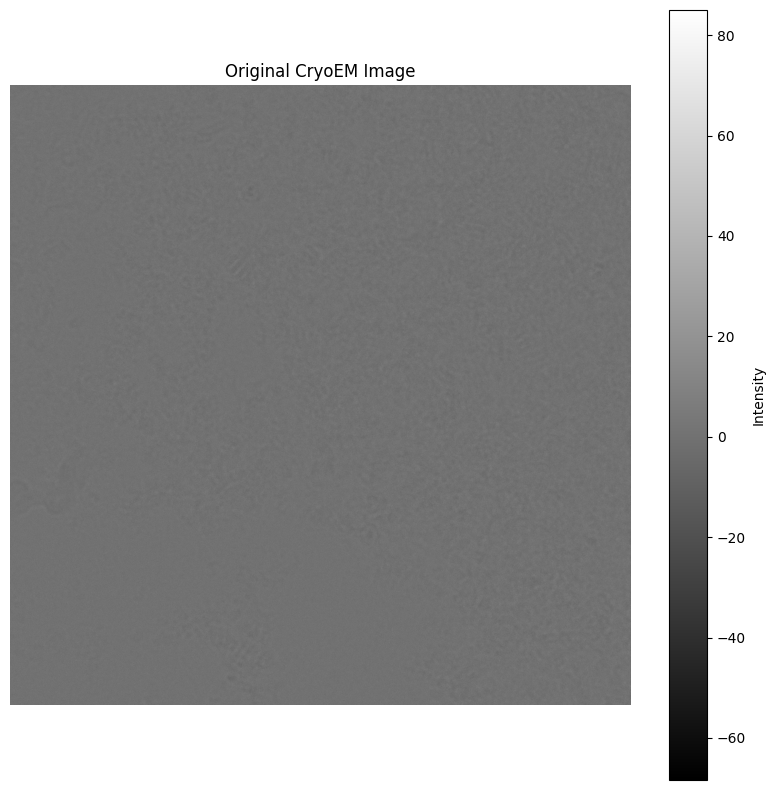

In [9]:
# Create analyzer instance
analyzer = FilamentAnalyzer(input_file, helical_rise, pixel_size)

# Load MRC file
data = analyzer.load_mrc()

# Display original data
plt.figure(figsize=(10, 10))
plt.imshow(data, cmap='gray')
plt.title('Original CryoEM Image')
plt.colorbar(label='Intensity')
plt.axis('off')
plt.show()

## 5. Apply Low-Pass Filter

Enhance filament-like features by removing low-frequency components.

Applying low-pass filter (sigma=30)...


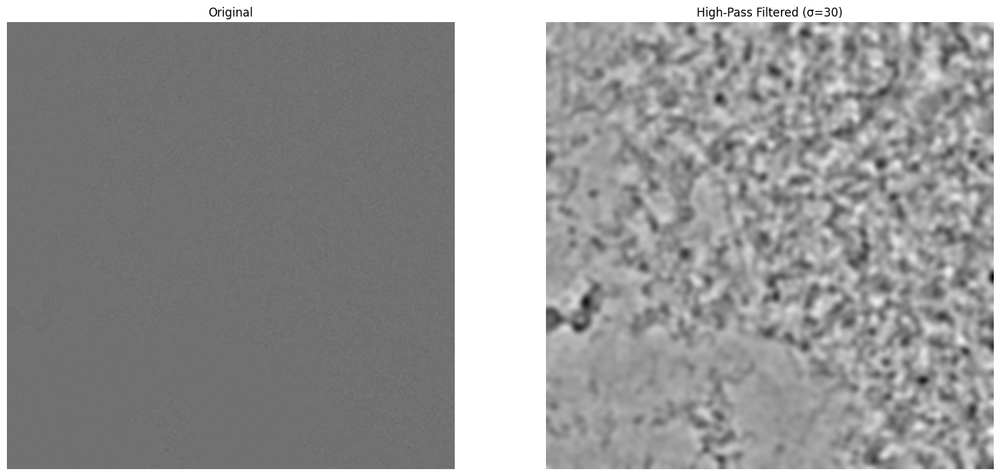

In [10]:
# Apply high-pass filter
filtered_data = analyzer.apply_low_pass_filter(sigma=filter_sigma)

# Display filtered data
fig, axes = plt.subplots(1, 2, figsize=(16, 7))

axes[0].imshow(data, cmap='gray')
axes[0].set_title('Original')
axes[0].axis('off')

axes[1].imshow(filtered_data, cmap='gray')
axes[1].set_title(f'High-Pass Filtered (σ={filter_sigma})')
axes[1].axis('off')

plt.tight_layout()
plt.show()

Image shape: (4096, 4096) (height, width)

Creating rectangular mask from line:
  Width: 500 pixels
  Head point: [0, 1500]
  Tail point: [1500, 4096]

Mask Configuration:
Head point: (0, 1500)
Tail point: (1500, 4096)
Center point: (750.0, 2798.0)
Length (head to tail): 2998.2 pixels
Width: 500 pixels
Angle: 60.0°


/var/folders/56/v2wj9b8x4r787dm0b7kx08hr0000gr/T/ipykernel_29479/551587037.py:100: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  rect_patch = Polygon(corners, fill=True, alpha=0.3,


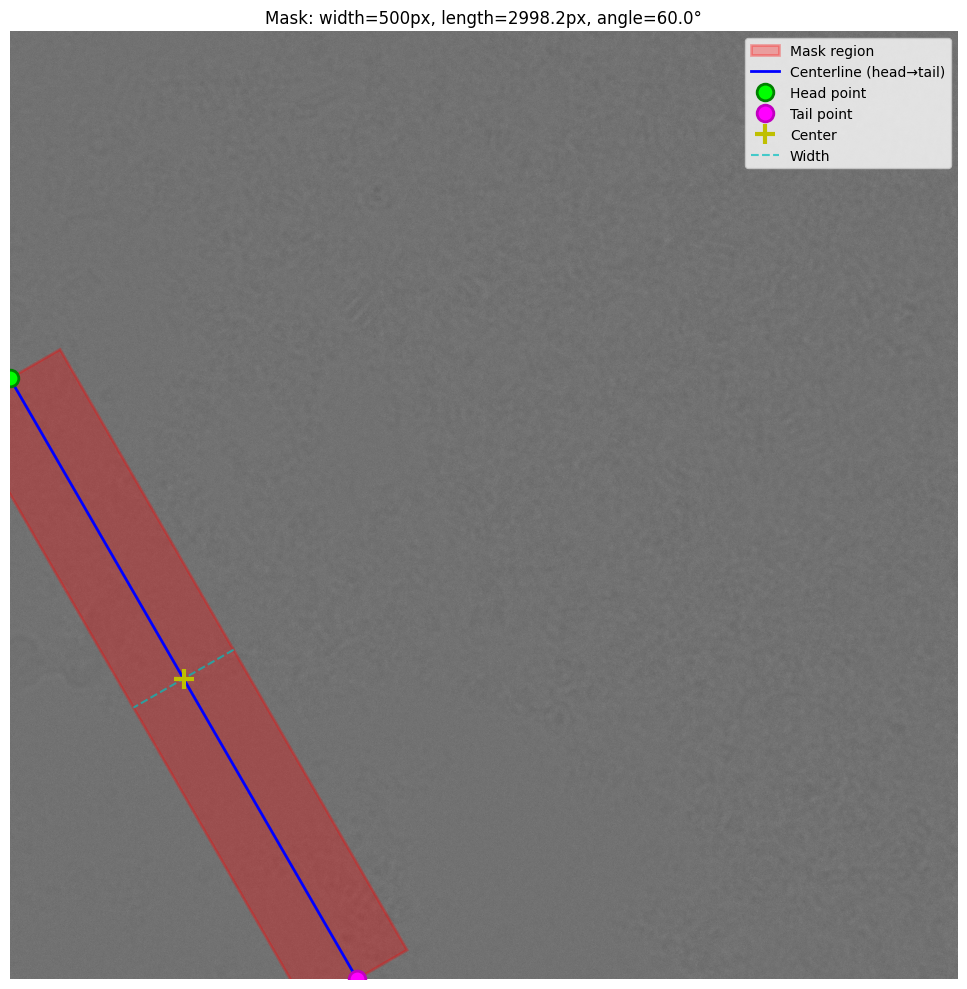


Mask Statistics:
  Total masked pixels: 1,427,067
  Percentage of image: 8.51%
  ✓ Mask fully within image boundaries

✓ Mask created successfully!


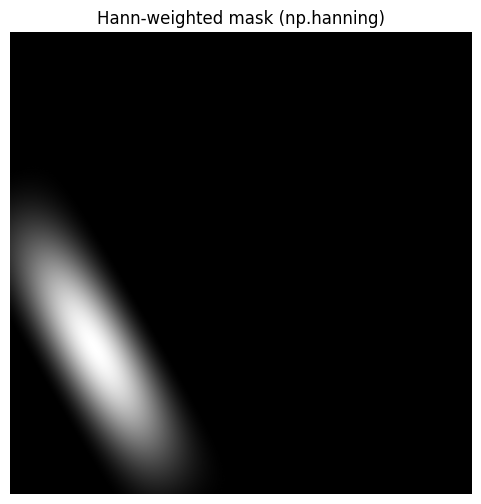


Generating Fourier transform comparison...


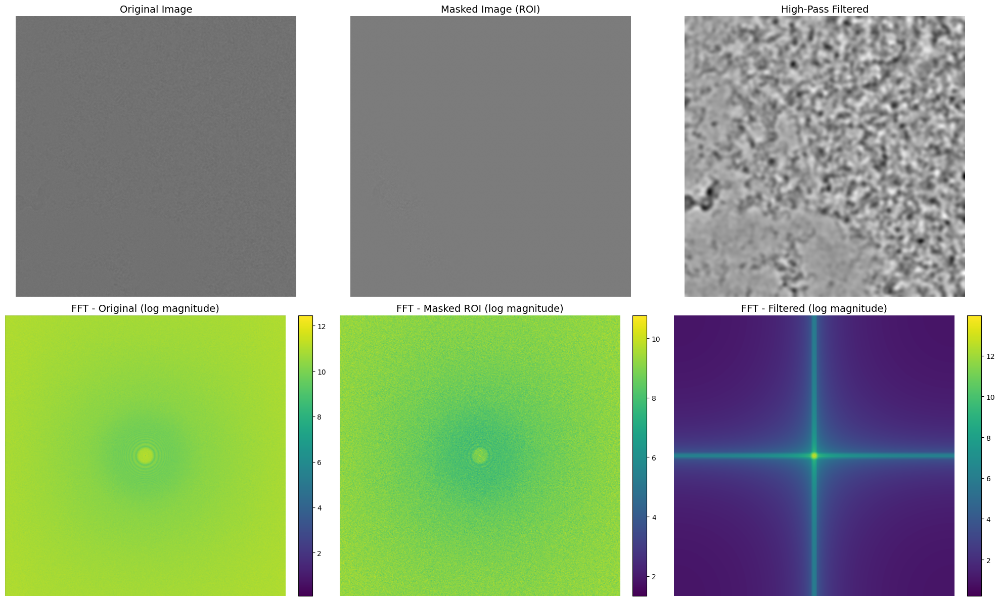


Fourier Transform Statistics:
Original FFT - Mean: 10.55, Max: 12.45
Masked FFT   - Mean: 8.84, Max: 10.77

Difference in mean magnitude: 1.71

✓ Analysis complete!


In [11]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.path import Path
from matplotlib.patches import Rectangle

class VSCodeMaskDrawer:
    def __init__(self, image):
        self.image = image
        self.mask = np.zeros_like(image, dtype=bool)
        self.height, self.width = image.shape[:2]
        
    def create_rectangular_mask_from_line(self, head_point, tail_point, width):
        """
        Create a rectangular mask defined by a centerline (head to tail) and width
        
        Parameters:
        -----------
        head_point : tuple or list
            [x, y] coordinates of the head point
        tail_point : tuple or list
            [x, y] coordinates of the tail point
        width : int
            Width of the rectangular mask (perpendicular to the head-tail line)
            
        Returns:
        --------
        mask : np.ndarray
            Boolean mask array
        """
        head_x, head_y = head_point
        tail_x, tail_y = tail_point
        
        # Calculate the center point
        center_x = (head_x + tail_x) / 2
        center_y = (head_y + tail_y) / 2
        
        # Calculate the length (distance from head to tail)
        length = np.sqrt((tail_x - head_x)**2 + (tail_y - head_y)**2)
        
        # Calculate the angle of the line
        angle = np.arctan2(tail_y - head_y, tail_x - head_x)
        
        print(f"\n{'='*60}")
        print(f"Mask Configuration:")
        print(f"{'='*60}")
        print(f"Head point: ({head_x}, {head_y})")
        print(f"Tail point: ({tail_x}, {tail_y})")
        print(f"Center point: ({center_x:.1f}, {center_y:.1f})")
        print(f"Length (head to tail): {length:.1f} pixels")
        print(f"Width: {width} pixels")
        print(f"Angle: {np.degrees(angle):.1f}°")
        print(f"{'='*60}")
        
        # Create the four corners of the rectangle
        # Rectangle centered at origin, then rotated and translated
        half_length = length / 2
        half_width = width / 2
        
        # Corners in local coordinate system (before rotation)
        corners_local = np.array([
            [-half_length, -half_width],
            [half_length, -half_width],
            [half_length, half_width],
            [-half_length, half_width]
        ])
        
        # Rotation matrix
        cos_a = np.cos(angle)
        sin_a = np.sin(angle)
        rotation_matrix = np.array([
            [cos_a, -sin_a],
            [sin_a, cos_a]
        ])
        
        # Rotate corners
        corners_rotated = corners_local @ rotation_matrix.T
        
        # Translate to center position
        corners = corners_rotated + np.array([center_x, center_y])
        
        # Create mask using polygon
        y_coords, x_coords = np.mgrid[0:self.height, 0:self.width]
        points = np.vstack((x_coords.ravel(), y_coords.ravel())).T
        
        path = Path(corners)
        mask_flat = path.contains_points(points)
        self.mask = mask_flat.reshape(self.height, self.width)
        
        # Clip mask to image boundaries
        clipped_pixels = self.mask.sum()
        
        # Visualization
        fig, ax = plt.subplots(figsize=(14, 10))
        ax.imshow(self.image, cmap='gray')
        
        # Draw the rectangle
        from matplotlib.patches import Polygon
        rect_patch = Polygon(corners, fill=True, alpha=0.3, 
                            color='red', edgecolor='red', linewidth=2,
                            label='Mask region')
        ax.add_patch(rect_patch)
        
        # Draw the centerline (head to tail)
        ax.plot([head_x, tail_x], [head_y, tail_y], 
               'b-', linewidth=2, label='Centerline (head→tail)')
        
        # Mark head and tail points
        ax.plot(head_x, head_y, 'go', markersize=12, 
               markeredgewidth=2, markerfacecolor='lime', 
               label='Head point', zorder=5)
        ax.plot(tail_x, tail_y, 'mo', markersize=12, 
               markeredgewidth=2, markerfacecolor='magenta', 
               label='Tail point', zorder=5)
        
        # Mark center point
        ax.plot(center_x, center_y, 'y+', markersize=15, 
               markeredgewidth=3, label='Center', zorder=5)
        
        # Draw width indicator (perpendicular line at center)
        perp_angle = angle + np.pi/2
        perp_dx = (half_width) * np.cos(perp_angle)
        perp_dy = (half_width) * np.sin(perp_angle)
        ax.plot([center_x - perp_dx, center_x + perp_dx], 
               [center_y - perp_dy, center_y + perp_dy],
               'c--', linewidth=1.5, alpha=0.7, label='Width')
        
        ax.set_title(f'Mask: width={width}px, length={length:.1f}px, angle={np.degrees(angle):.1f}°', 
                    fontsize=12)
        ax.legend(loc='upper right', fontsize=10)
        ax.axis('off')
        
        # Set proper limits
        ax.set_xlim(0, self.width)
        ax.set_ylim(self.height, 0)  # Inverted Y axis for image coordinates
        
        plt.tight_layout()
        plt.show()
        
        # Print statistics
        print(f"\nMask Statistics:")
        print(f"  Total masked pixels: {clipped_pixels:,}")
        print(f"  Percentage of image: {100*clipped_pixels/self.mask.size:.2f}%")
        
        # Check if mask is partially outside image
        theoretical_area = length * width
        if clipped_pixels < theoretical_area * 0.95:  # 5% tolerance
            print(f"  ⚠ Mask partially outside image boundaries")
            print(f"  Theoretical area: {theoretical_area:.0f} pixels")
            print(f"  Actual area: {clipped_pixels} pixels")
        else:
            print(f"  ✓ Mask fully within image boundaries")
        print(f"{'='*60}")
        
        return self.mask

def hann_weighted_rectangle_mask(image_shape, head_point, tail_point, width, pad_px=300):
    H, W = image_shape
    head_x, head_y = head_point
    tail_x, tail_y = tail_point

    cx = 0.5 * (head_x + tail_x)
    cy = 0.5 * (head_y + tail_y)

    L0 = float(np.hypot(tail_x - head_x, tail_y - head_y))  # original centerline length
    W0 = float(width)                                       # original width

    half_L = L0 / 2.0 + pad_px
    half_W = W0 / 2.0 + pad_px

    L_eff = 2.0 * half_L    # ✅ expanded length
    W_eff = 2.0 * half_W    # ✅ expanded width

    angle = float(np.arctan2(tail_y - head_y, tail_x - head_x))

    yy, xx = np.mgrid[0:H, 0:W]
    X = xx - cx
    Y = yy - cy

    ca = np.cos(-angle)
    sa = np.sin(-angle)
    u = X * ca - Y * sa
    v = X * sa + Y * ca

    inside = (np.abs(u) <= half_L) & (np.abs(v) <= half_W)

    NL = max(3, int(np.round(L_eff)) + 1)
    NW = max(3, int(np.round(W_eff)) + 1)

    wL = np.hanning(NL).astype(np.float32)
    wW = np.hanning(NW).astype(np.float32)

    # ✅ map using expanded sizes (not L0/W0)
    tL = (u[inside] + half_L) / L_eff * (NL - 1)
    tW = (v[inside] + half_W) / W_eff * (NW - 1)

    xL = np.arange(NL, dtype=np.float32)
    xW = np.arange(NW, dtype=np.float32)
    w_u = np.interp(tL.astype(np.float32), xL, wL).astype(np.float32)
    w_v = np.interp(tW.astype(np.float32), xW, wW).astype(np.float32)

    mask = np.zeros((H, W), dtype=np.float32)
    mask[inside] = w_u * w_v
    return mask



def compare_fourier_transforms(image, mask, filtered_data=None):
    """Compare Fourier transforms with and without mask"""
    
    # Apply mask
    if mask.dtype == bool:
        masked_image = image.copy()
        masked_image[~mask] = 0
    else:
        masked_image = image * mask

    # Compute Fourier transforms
    fft_original = np.fft.fft2(image)
    fft_original_shifted = np.fft.fftshift(fft_original)
    
    fft_masked = np.fft.fft2(masked_image)
    fft_masked_shifted = np.fft.fftshift(fft_masked)
    
    # Magnitude spectra (log scale for better visualization)
    magnitude_original = np.log(1 + np.abs(fft_original_shifted))
    magnitude_masked = np.log(1 + np.abs(fft_masked_shifted))
    
    # Create comparison plot
    if filtered_data is not None:
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
    else:
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Row 1: Spatial domain
    axes[0, 0].imshow(image, cmap='gray')
    axes[0, 0].set_title('Original Image', fontsize=14)
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(masked_image, cmap='gray')
    axes[0, 1].set_title('Masked Image (ROI)', fontsize=14)
    axes[0, 1].axis('off')
    
    if filtered_data is not None:
        axes[0, 2].imshow(filtered_data, cmap='gray')
        axes[0, 2].set_title('High-Pass Filtered', fontsize=14)
        axes[0, 2].axis('off')
    
    # Row 2: Frequency domain
    im1 = axes[1, 0].imshow(magnitude_original, cmap='viridis')
    axes[1, 0].set_title('FFT - Original (log magnitude)', fontsize=14)
    axes[1, 0].axis('off')
    plt.colorbar(im1, ax=axes[1, 0], fraction=0.046, pad=0.04)
    
    im2 = axes[1, 1].imshow(magnitude_masked, cmap='viridis')
    axes[1, 1].set_title('FFT - Masked ROI (log magnitude)', fontsize=14)
    axes[1, 1].axis('off')
    plt.colorbar(im2, ax=axes[1, 1], fraction=0.046, pad=0.04)
    
    if filtered_data is not None:
        fft_filtered = np.fft.fft2(filtered_data)
        fft_filtered_shifted = np.fft.fftshift(fft_filtered)
        magnitude_filtered = np.log(1 + np.abs(fft_filtered_shifted))
        
        im3 = axes[1, 2].imshow(magnitude_filtered, cmap='viridis')
        axes[1, 2].set_title('FFT - Filtered (log magnitude)', fontsize=14)
        axes[1, 2].axis('off')
        plt.colorbar(im3, ax=axes[1, 2], fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics
    print(f"\n{'='*60}")
    print(f"Fourier Transform Statistics:")
    print(f"{'='*60}")
    print(f"Original FFT - Mean: {magnitude_original.mean():.2f}, Max: {magnitude_original.max():.2f}")
    print(f"Masked FFT   - Mean: {magnitude_masked.mean():.2f}, Max: {magnitude_masked.max():.2f}")
    print(f"\nDifference in mean magnitude: {abs(magnitude_original.mean() - magnitude_masked.mean()):.2f}")
    print(f"{'='*60}")
    
    return magnitude_original, magnitude_masked


# ============== CREATE MASK WITH HEAD, TAIL, AND WIDTH ==============
print("Image shape:", data.shape, "(height, width)")

# Define mask parameters
width = 500              # Width of the rectangular mask
head_point = [0, 1500]    # [x, y] coordinates of head
tail_point = [1500, 4096]   # [x, y] coordinates of tail

print(f"\nCreating rectangular mask from line:")
print(f"  Width: {width} pixels")
print(f"  Head point: {head_point}")
print(f"  Tail point: {tail_point}")

drawer = VSCodeMaskDrawer(data)
mask = drawer.create_rectangular_mask_from_line(head_point, tail_point, width)

hann_mask = hann_weighted_rectangle_mask(
    data.shape, head_point=head_point, tail_point=tail_point, width=width
)

print(f"\n✓ Mask created successfully!")
plt.figure(figsize=(6,6))
plt.imshow(hann_mask, cmap="gray")
plt.title("Hann-weighted mask (np.hanning)")
plt.axis("off")
plt.show()

# Compare Fourier transforms
print("\nGenerating Fourier transform comparison...")
magnitude_orig, magnitude_masked = compare_fourier_transforms(
    data, hann_mask, filtered_data=filtered_data
)

print("\n✓ Analysis complete!")

Original image shape: (4096, 4096)

No binning applied (bin_factor = 1)

Patch size: 1024 × 1024 pixels
Step size: 512 × 512 pixels
Overlap: 50%

Grid shape: 7 rows × 7 columns
Total patches: 49

FFT Averaging kernel size: 3×3
Each FFT will be averaged with up to 8 neighbors
(Border patches have fewer neighbors)

Using contrast enhancement: 5th to 95th percentile

Generating patch grid overlay...


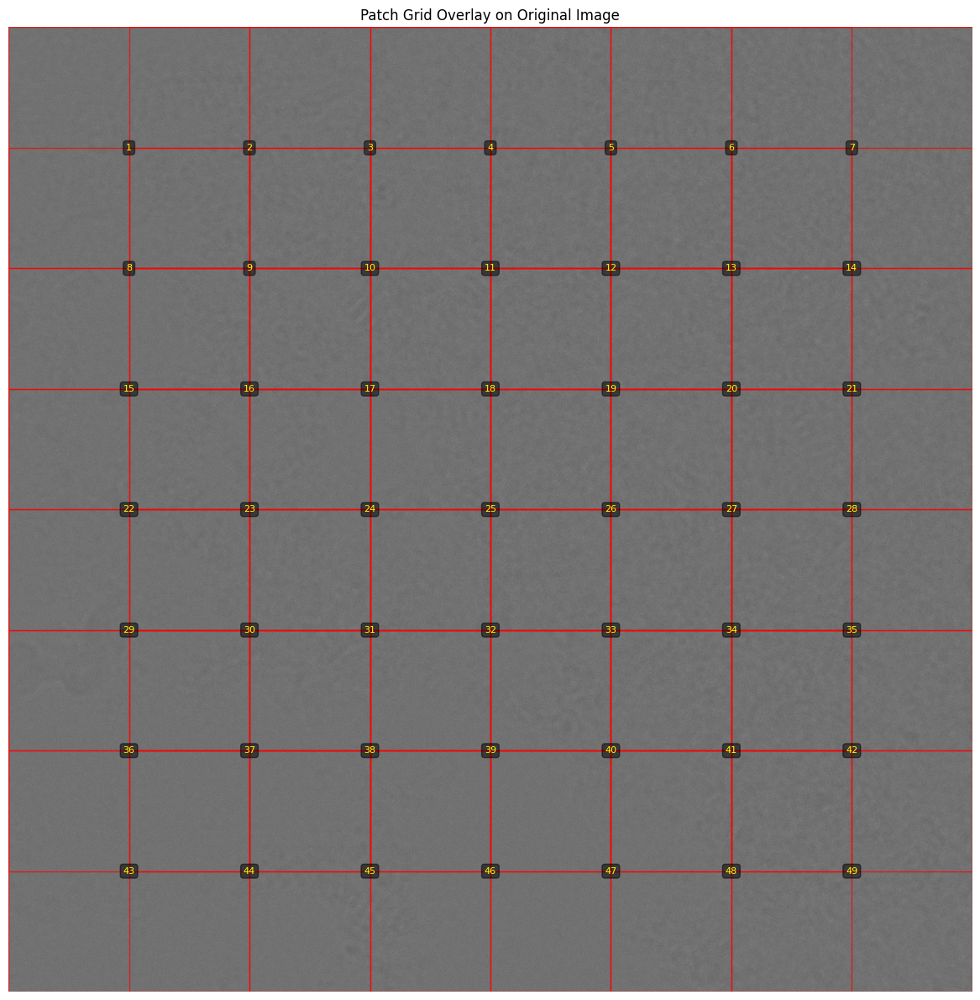

Generating patch visualizations...


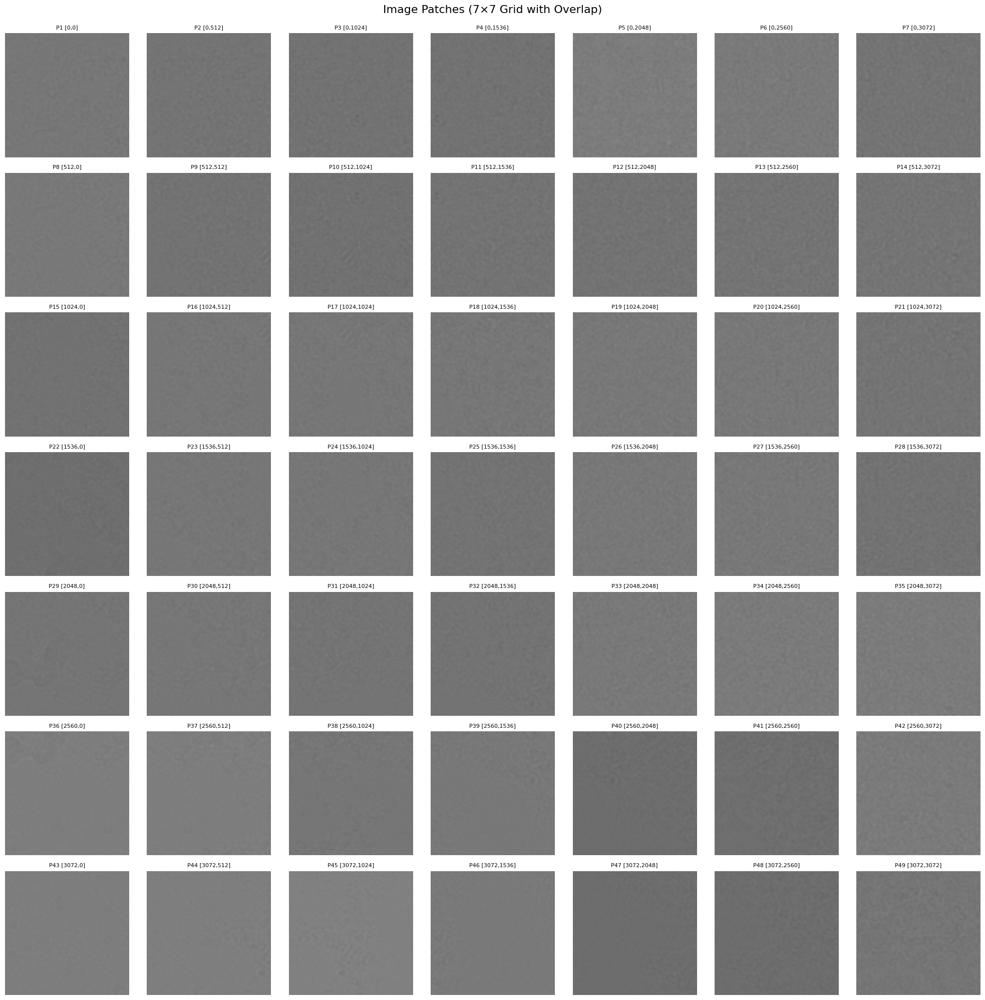

Generating FFT comparison (original vs averaged)...


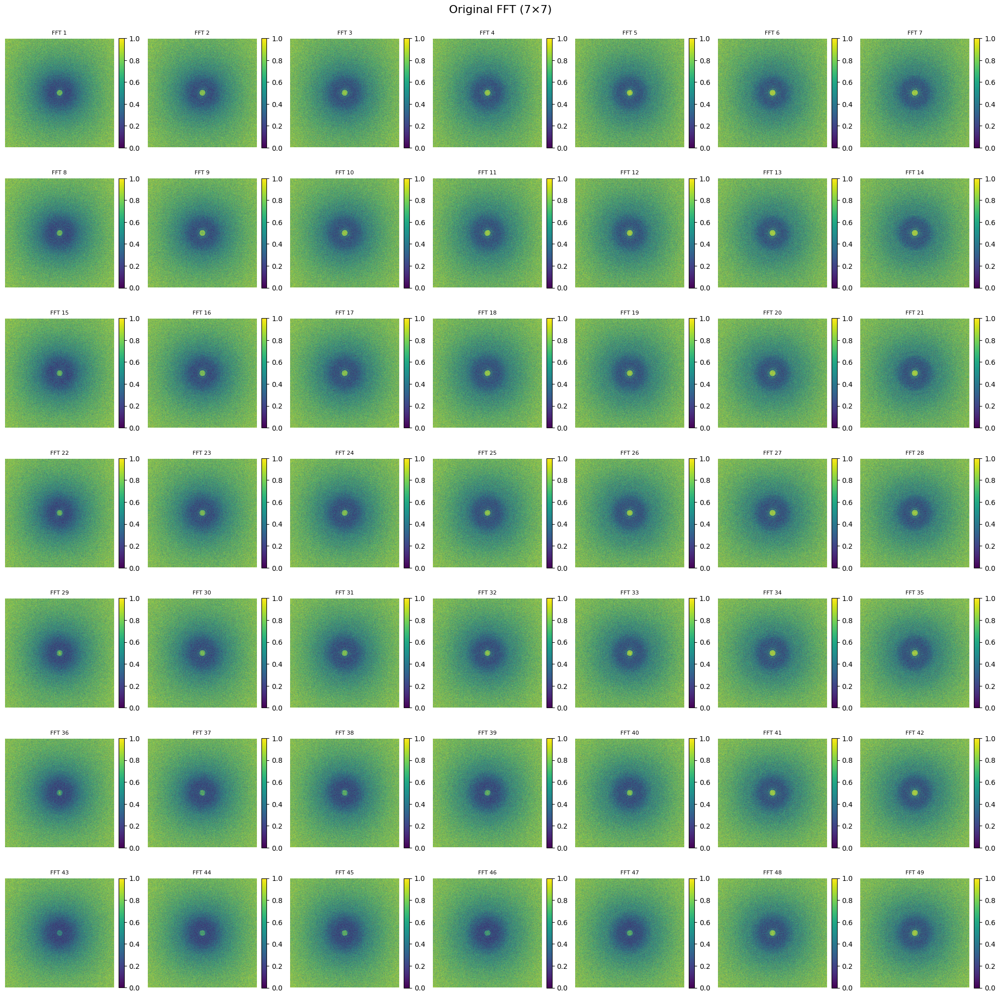

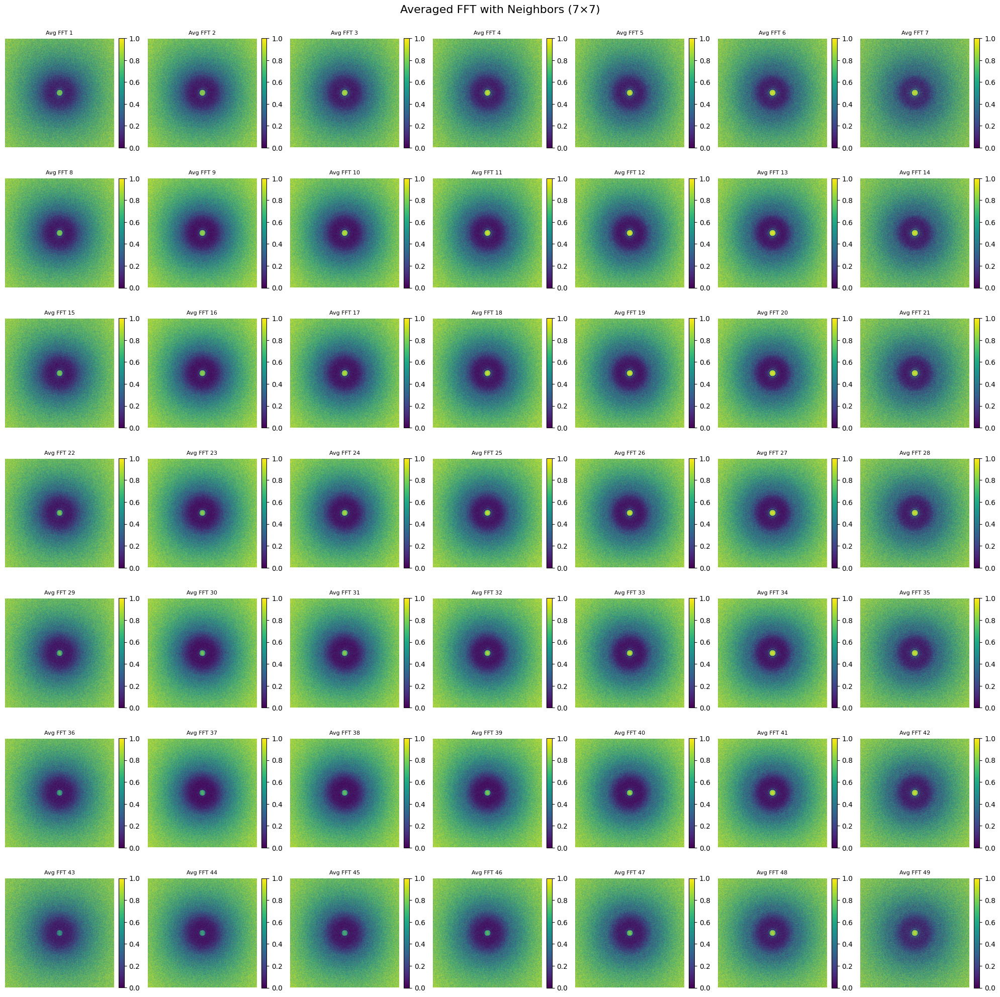


✓ Analysis complete!

FFT Statistics Comparison:
Patch  1 [R1C1]: Original=  9.16, Averaged=  9.17, Diff= +0.00
Patch  2 [R1C2]: Original=  9.16, Averaged=  9.17, Diff= +0.01
Patch  3 [R1C3]: Original=  9.16, Averaged=  9.17, Diff= +0.01
Patch  4 [R1C4]: Original=  9.17, Averaged=  9.17, Diff= +0.00
Patch  5 [R1C5]: Original=  9.16, Averaged=  9.16, Diff= +0.00
Patch  6 [R1C6]: Original=  9.15, Averaged=  9.16, Diff= +0.00
Patch  7 [R1C7]: Original=  9.15, Averaged=  9.15, Diff= +0.00
Patch  8 [R2C1]: Original=  9.17, Averaged=  9.17, Diff= -0.00
Patch  9 [R2C2]: Original=  9.17, Averaged=  9.17, Diff= +0.00
Patch 10 [R2C3]: Original=  9.18, Averaged=  9.17, Diff= -0.00
Patch 11 [R2C4]: Original=  9.18, Averaged=  9.17, Diff= -0.00
Patch 12 [R2C5]: Original=  9.17, Averaged=  9.17, Diff= -0.00
Patch 13 [R2C6]: Original=  9.16, Averaged=  9.16, Diff= +0.00
Patch 14 [R2C7]: Original=  9.15, Averaged=  9.16, Diff= +0.01
Patch 15 [R3C1]: Original=  9.18, Averaged=  9.17, Diff= -0.01
Patch

In [12]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import uniform_filter

def bin_image(image, bin_factor):
    """
    Bin (downsample) image by averaging pixels
    
    Parameters:
    -----------
    image : 2D array
        Input image
    bin_factor : int
        Binning factor (2 = 2×2 binning, 3 = 3×3 binning, etc.)
    
    Returns:
    --------
    binned : 2D array
        Binned image
    """
    if bin_factor == 1:
        return image
    
    h, w = image.shape
    new_h = h // bin_factor
    new_w = w // bin_factor
    
    # Crop to make dimensions divisible by bin_factor
    cropped = image[:new_h * bin_factor, :new_w * bin_factor]
    
    # Reshape and average
    binned = cropped.reshape(new_h, bin_factor, new_w, bin_factor).mean(axis=(1, 3))
    
    return binned


def create_overlapping_patches_and_fft(image, patch_size, step_size):
    """
    Create overlapping patches and compute FFT for each patch
    
    Parameters:
    -----------
    image : 2D array
        Input image
    patch_size : tuple (height, width)
        Size of each patch
    step_size : tuple (step_h, step_w)
        Step size for sliding window
    
    Returns:
    --------
    patches : list of 2D arrays
        List of image patches
    fft_patches : list of 2D arrays
        List of FFT magnitude (log scale) for each patch
    positions : list of tuples
        List of (y_start, x_start) positions for each patch
    grid_shape : tuple
        Shape of the patch grid (n_rows, n_cols)
    """
    h, w = image.shape
    patch_h, patch_w = patch_size
    step_h, step_w = step_size
    
    patches = []
    fft_patches = []
    positions = []
    
    # Calculate how many patches fit
    n_rows = (h - patch_h) // step_h + 1
    n_cols = (w - patch_w) // step_w + 1
    
    for i in range(n_rows):
        for j in range(n_cols):
            # Calculate patch position
            y_start = i * step_h
            x_start = j * step_w
            y_end = min(y_start + patch_h, h)
            x_end = min(x_start + patch_w, w)
            
            # Extract patch
            patch = image[y_start:y_end, x_start:x_end]
            patches.append(patch)
            positions.append((y_start, x_start))
            
            # Compute FFT for this patch
            fft = np.fft.fft2(patch)
            fft_shifted = np.fft.fftshift(fft)
            magnitude = np.log(1 + np.abs(fft_shifted))
            fft_patches.append(magnitude)
    
    return patches, fft_patches, positions, (n_rows, n_cols)


def average_adjacent_fft(fft_patches, grid_shape, kernel_size=3):
    """
    Average each FFT with its surrounding neighbors
    
    Parameters:
    -----------
    fft_patches : list of 2D arrays
        List of FFT magnitudes
    grid_shape : tuple (n_rows, n_cols)
        Shape of the patch grid
    kernel_size : int
        Size of averaging kernel (3 = 3×3 neighborhood, 5 = 5×5, etc.)
        Must be odd number
    
    Returns:
    --------
    averaged_fft_patches : list of 2D arrays
        List of averaged FFT magnitudes
    """
    n_rows, n_cols = grid_shape
    n_patches = len(fft_patches)
    
    # Get FFT shape (all patches should have same FFT size)
    fft_h, fft_w = fft_patches[0].shape
    
    # Create 3D array to hold all FFTs
    fft_grid = np.zeros((n_rows, n_cols, fft_h, fft_w))
    
    for idx, fft_mag in enumerate(fft_patches):
        row = idx // n_cols
        col = idx % n_cols
        fft_grid[row, col] = fft_mag
    
    # Average with neighbors
    averaged_fft_patches = []
    radius = kernel_size // 2
    
    for idx in range(n_patches):
        row = idx // n_cols
        col = idx % n_cols
        
        # Define neighborhood bounds
        row_start = max(0, row - radius)
        row_end = min(n_rows, row + radius + 1)
        col_start = max(0, col - radius)
        col_end = min(n_cols, col + radius + 1)
        
        # Extract neighborhood
        neighborhood = fft_grid[row_start:row_end, col_start:col_end]
        
        # Average across the neighborhood (first two dimensions)
        averaged_fft = np.mean(neighborhood, axis=(0, 1))
        averaged_fft_patches.append(averaged_fft)
    
    return averaged_fft_patches


def normalize_for_display(fft_mag, percentile_low=1, percentile_high=99):
    """
    Normalize FFT magnitude for better contrast using percentile clipping
    """
    vmin = np.percentile(fft_mag, percentile_low)
    vmax = np.percentile(fft_mag, percentile_high)
    
    normalized = np.clip(fft_mag, vmin, vmax)
    normalized = (normalized - vmin) / (vmax - vmin)
    
    return normalized


def visualize_fft_comparison(fft_patches, averaged_fft_patches, grid_shape,
                             percentile_low=1, percentile_high=99):
    """
    Compare original FFT and averaged FFT side by side
    """
    n_rows, n_cols = grid_shape
    
    # Create figure with original FFTs
    fig1, axes1 = plt.subplots(n_rows, n_cols, figsize=(20, 20))
    if n_rows == 1:
        axes1 = axes1.reshape(1, -1)
    if n_cols == 1:
        axes1 = axes1.reshape(-1, 1)
    
    fig1.suptitle(f'Original FFT ({n_rows}×{n_cols})', fontsize=16, y=0.995)
    
    for idx, (ax, fft_mag) in enumerate(zip(axes1.flat, fft_patches)):
        fft_normalized = normalize_for_display(fft_mag, percentile_low, percentile_high)
        im = ax.imshow(fft_normalized, cmap='viridis', vmin=0, vmax=1)
        ax.set_title(f'FFT {idx+1}', fontsize=8)
        ax.axis('off')
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()
    
    # Create figure with averaged FFTs
    fig2, axes2 = plt.subplots(n_rows, n_cols, figsize=(20, 20))
    if n_rows == 1:
        axes2 = axes2.reshape(1, -1)
    if n_cols == 1:
        axes2 = axes2.reshape(-1, 1)
    
    fig2.suptitle(f'Averaged FFT with Neighbors ({n_rows}×{n_cols})', fontsize=16, y=0.995)
    
    for idx, (ax, fft_mag) in enumerate(zip(axes2.flat, averaged_fft_patches)):
        fft_normalized = normalize_for_display(fft_mag, percentile_low, percentile_high)
        im = ax.imshow(fft_normalized, cmap='viridis', vmin=0, vmax=1)
        ax.set_title(f'Avg FFT {idx+1}', fontsize=8)
        ax.axis('off')
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()


def visualize_overlapping_patches_and_fft(image, patches, fft_patches, positions, grid_shape,
                                          percentile_low=1, percentile_high=99):
    """
    Visualize all overlapping patches and their FFTs with improved contrast
    """
    n_rows, n_cols = grid_shape
    
    # Create figure with patches
    fig1, axes1 = plt.subplots(n_rows, n_cols, figsize=(20, 20))
    if n_rows == 1:
        axes1 = axes1.reshape(1, -1)
    if n_cols == 1:
        axes1 = axes1.reshape(-1, 1)
    
    fig1.suptitle(f'Image Patches ({n_rows}×{n_cols} Grid with Overlap)', fontsize=16, y=0.995)
    
    for idx, (ax, patch, pos) in enumerate(zip(axes1.flat, patches, positions)):
        ax.imshow(patch, cmap='gray')
        ax.set_title(f'P{idx+1} [{pos[0]},{pos[1]}]', fontsize=8)
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()


def visualize_patch_grid_overlay(image, positions, patch_size, grid_shape):
    """
    Visualize the patch grid overlay on the original image
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(image, cmap='gray')
    ax.set_title('Patch Grid Overlay on Original Image')
    
    patch_h, patch_w = patch_size
    
    # Draw rectangles for each patch
    from matplotlib.patches import Rectangle
    for idx, (y_start, x_start) in enumerate(positions):
        rect = Rectangle((x_start, y_start), patch_w, patch_h,
                         fill=False, edgecolor='red', linewidth=1, alpha=0.7)
        ax.add_patch(rect)
        
        # Add patch number at center
        ax.text(x_start + patch_w/2, y_start + patch_h/2, str(idx+1),
               color='yellow', fontsize=8, ha='center', va='center',
               bbox=dict(boxstyle='round', facecolor='black', alpha=0.5))
    
    ax.axis('off')
    plt.tight_layout()
    plt.show()


# ============== MAIN EXECUTION ==============
print(f"Original image shape: {data.shape}")

# ============== BINNING OPTION ==============
bin_factor = 1  # Change this value to adjust binning

if bin_factor > 1:
    print(f"\nApplying {bin_factor}×{bin_factor} binning...")
    data_binned = bin_image(data, bin_factor)
    print(f"Binned image shape: {data_binned.shape}")
    print(f"Resolution reduction: {bin_factor}× in each dimension")
    print(f"Speed improvement: ~{bin_factor**2}×\n")
    
    # Show original vs binned
    fig, axes = plt.subplots(1, 2, figsize=(16, 7))
    axes[0].imshow(data, cmap='gray')
    axes[0].set_title(f'Original Image {data.shape}')
    axes[0].axis('off')
    
    axes[1].imshow(data_binned, cmap='gray')
    axes[1].set_title(f'Binned Image (bin{bin_factor}) {data_binned.shape}')
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    analysis_data = data_binned
else:
    print("\nNo binning applied (bin_factor = 1)")
    analysis_data = data

# Define patch size
h, w = analysis_data.shape
base_patch_h = h // 4
base_patch_w = w // 4

patch_size = (base_patch_h, base_patch_w)

# Define step size for overlap
overlap_factor = 0.5  # 50% overlap
step_size = (int(base_patch_h * overlap_factor), int(base_patch_w * overlap_factor))

print(f"\nPatch size: {patch_size[0]} × {patch_size[1]} pixels")
print(f"Step size: {step_size[0]} × {step_size[1]} pixels")
print(f"Overlap: {int((1-overlap_factor)*100)}%\n")

# Create overlapping patches and compute FFTs
patches, fft_patches, positions, grid_shape = create_overlapping_patches_and_fft(
    analysis_data, patch_size, step_size
)

print(f"Grid shape: {grid_shape[0]} rows × {grid_shape[1]} columns")
print(f"Total patches: {len(patches)}\n")

# ============== FFT AVERAGING OPTION ==============
# kernel_size options:
# 3 = average with 8 neighbors (3×3 kernel)
# 5 = average with 24 neighbors (5×5 kernel)
# 1 = no averaging (just the patch itself)

kernel_size = 3  # Change this to adjust neighborhood size

print(f"FFT Averaging kernel size: {kernel_size}×{kernel_size}")
if kernel_size > 1:
    print(f"Each FFT will be averaged with up to {kernel_size**2 - 1} neighbors")
    print("(Border patches have fewer neighbors)\n")
    
    # Average FFTs with neighbors
    averaged_fft_patches = average_adjacent_fft(fft_patches, grid_shape, kernel_size)
else:
    print("No FFT averaging applied\n")
    averaged_fft_patches = fft_patches

# Adjust percentiles for contrast
percentile_low = 5
percentile_high = 95

print(f"Using contrast enhancement: {percentile_low}th to {percentile_high}th percentile\n")

# Visualization 1: Show patch grid overlay
print("Generating patch grid overlay...")
visualize_patch_grid_overlay(analysis_data, positions, patch_size, grid_shape)

# Visualization 2: Show all patches
print("Generating patch visualizations...")
visualize_overlapping_patches_and_fft(analysis_data, patches, fft_patches, positions, grid_shape,
                                      percentile_low=percentile_low, percentile_high=percentile_high)

# Visualization 3: Compare original FFT vs averaged FFT
if kernel_size > 1:
    print("Generating FFT comparison (original vs averaged)...")
    visualize_fft_comparison(fft_patches, averaged_fft_patches, grid_shape,
                            percentile_low=percentile_low, percentile_high=percentile_high)

print("\n✓ Analysis complete!")

# Print statistics
print("\n" + "="*80)
print(f"FFT Statistics Comparison:")
print("="*80)
for idx in range(len(fft_patches)):
    row = idx // grid_shape[1]
    col = idx % grid_shape[1]
    orig_mean = fft_patches[idx].mean()
    avg_mean = averaged_fft_patches[idx].mean()
    print(f"Patch {idx+1:2d} [R{row+1}C{col+1}]: Original={orig_mean:6.2f}, Averaged={avg_mean:6.2f}, Diff={avg_mean-orig_mean:+6.2f}")

FILAMENT DETECTION: 0.83Å pixels, Bandpass up to 2Å resolution

Analyzing patch 23...

Physical Parameters:
  - Pixel size: 0.83 Å/pixel
  - Filament periodicity: 4.7 Å
  - Nyquist frequency: 0.6024 Å⁻¹
  - Nyquist resolution: 1.66 Å

Low-Pass Filter:
  - Cutoff resolution: 4.0 Å
  - Cutoff frequency: 0.2500 Å⁻¹
  - Outer radius: 212.5 pixels

Target Signal:
  - Target frequency: 0.2128 Å⁻¹ (1/4.7Å)
  - FFT stripe position: ±180.8 pixels from center

Detection Parameters:
  - Bandpass: 30 - 212.5 pixels
  - Resolution range: ∞ to 4.0Å
  - Stripe positions: y=0, ±180.8 pixels
  - Stripe width: 20 pixels
  - Angle search range: (-90, 90)
Nyquist frequency: 0.6024 Å⁻¹ (1.66 Å resolution)
Low-pass cutoff: 4.0 Å resolution (0.2500 Å⁻¹)
Low-pass radius: 212.5 pixels

FFT shape: (1024, 1024)
Detecting periodicity: 4.7 Å
Stripe positions (pixels from center): [0, 180.83404255319147]
Creating 3 stripes total: 1 at y=0, 2 at y=±180.83404255319147

Searching for best rotation angle...
Bandpass: 3

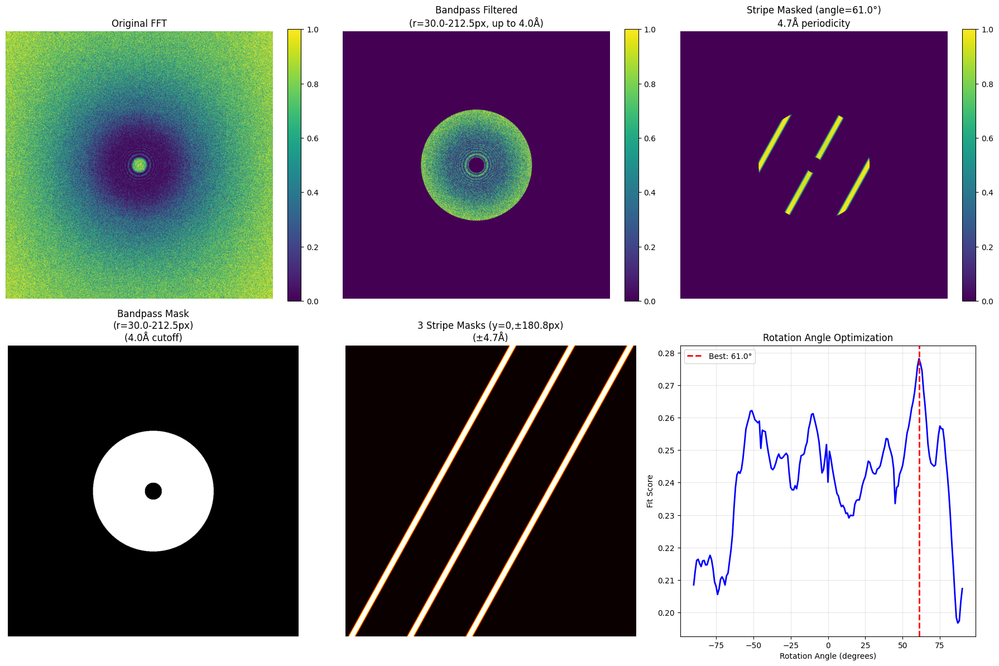


RESULT: Best angle = 61.0°, Fit score = 0.278

PARAMETER ADJUSTMENT GUIDE:
  - outer_resolution_angstrom: 2.0-3.0 Å (cutoff for low-pass)
  - inner_radius: 3-10 pixels (high-pass, removes DC)
  - stripe_width: 15-30 pixels (detection region width)
  - Current bandpass: keeping frequencies for ∞ to 4.0Å resolution


In [14]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import rotate, uniform_filter
from scipy.ndimage import gaussian_filter

def calculate_fft_frequency_to_pixel(fft_shape, pixel_size_angstrom, frequency_angstrom):
    """
    Convert real-space frequency (1/Angstrom) to FFT pixel position
    
    Parameters:
    -----------
    fft_shape : tuple (height, width)
        Shape of the FFT
    pixel_size_angstrom : float
        Pixel size in Angstroms (physical size of one pixel in real space)
    frequency_angstrom : float
        Frequency in 1/Angstrom (e.g., 1/4.7 for 4.7 Å periodicity)
    
    Returns:
    --------
    pixel_position : float
        Position in FFT pixels from center
    """
    h, w = fft_shape
    
    # Nyquist frequency in 1/Angstrom
    nyquist_freq = 1.0 / (2.0 * pixel_size_angstrom)
    
    # FFT pixel corresponding to this frequency
    pixel_position = (frequency_angstrom / nyquist_freq) * (min(h, w) / 2)
    
    return pixel_position


def calculate_resolution_to_pixel(fft_shape, pixel_size_angstrom, resolution_angstrom):
    """
    Convert resolution (Angstroms) to FFT pixel position
    
    Parameters:
    -----------
    fft_shape : tuple (height, width)
        Shape of the FFT
    pixel_size_angstrom : float
        Pixel size in Angstroms
    resolution_angstrom : float
        Resolution in Angstroms (e.g., 2.0 for 2Å resolution)
    
    Returns:
    --------
    pixel_position : float
        Position in FFT pixels from center
    """
    # Convert resolution to frequency
    frequency = 1.0 / resolution_angstrom
    return calculate_fft_frequency_to_pixel(fft_shape, pixel_size_angstrom, frequency)


def create_stripe_mask(fft_shape, y_positions, stripe_width=20, angle=0):
    """
    Create a mask for 3 horizontal stripes that can be rotated
    """
    h, w = fft_shape
    center_y, center_x = h // 2, w // 2
    
    # Create coordinate grids centered at (0, 0)
    y, x = np.ogrid[-center_y:h-center_y, -center_x:w-center_x]
    
    # Rotate coordinates
    angle_rad = np.radians(-angle)
    y_rot = y * np.cos(angle_rad) - x * np.sin(angle_rad)
    x_rot = y * np.sin(angle_rad) + x * np.cos(angle_rad)
    
    # Create mask for all stripes
    mask = np.zeros(fft_shape, dtype=bool)
    half_width = stripe_width // 2
    
    for y_pos in y_positions:
        if y_pos == 0:
            # Center stripe (along x-axis)
            mask |= (np.abs(y_rot) <= half_width)
        else:
            # Two symmetric stripes above and below x-axis
            mask |= (np.abs(y_rot - y_pos) <= half_width)
            mask |= (np.abs(y_rot + y_pos) <= half_width)
    
    return mask

def soften_mask(binary_mask, sigma=2.0):
    """
    Feather a boolean mask into a soft float mask using Gaussian blur.
    """
    m = binary_mask.astype(np.float32)
    m = gaussian_filter(m, sigma=sigma)
    if m.max() > 0:
        m /= m.max()  # normalize to [0,1]
    return m

def create_bandpass_mask(fft_shape, inner_radius=5, outer_radius=None):
    """
    Create a bandpass filter mask
    
    Parameters:
    -----------
    fft_shape : tuple (height, width)
        Shape of the FFT
    inner_radius : float
        Inner radius (high-pass, removes low frequencies)
    outer_radius : float or None
        Outer radius (low-pass, removes high frequencies beyond this)
        This should be set based on resolution (e.g., 2Å)
    
    Returns:
    --------
    mask : 2D boolean array
        Bandpass mask
    """
    h, w = fft_shape
    center_y, center_x = h // 2, w // 2
    
    y, x = np.ogrid[-center_y:h-center_y, -center_x:w-center_x]
    radius = np.sqrt(x**2 + y**2)
    
    if outer_radius is None:
        # If not specified, use full range
        mask = (radius >= inner_radius)
    else:
        # Bandpass: keep frequencies between inner and outer radius
        mask = (radius >= inner_radius) & (radius <= outer_radius)
    
    return mask


def calculate_stripe_fit(fft_magnitude, stripe_mask, bandpass_mask):
    fft_filtered = fft_magnitude * bandpass_mask

    if stripe_mask.dtype == bool:
        combined = stripe_mask & bandpass_mask
        if combined.sum() == 0:
            return 0
        stripe_intensity = fft_filtered[combined].mean()

        background_mask = bandpass_mask & ~stripe_mask
        if background_mask.sum() == 0:
            return stripe_intensity
        background_intensity = fft_filtered[background_mask].mean()
        return stripe_intensity / (background_intensity + 1e-10)

    # float mask: weighted means
    w = stripe_mask * bandpass_mask.astype(np.float32)
    w_sum = w.sum()
    if w_sum <= 1e-10:
        return 0
    stripe_intensity = (fft_filtered * w).sum() / w_sum

    bw = (1.0 - stripe_mask) * bandpass_mask.astype(np.float32)
    bw_sum = bw.sum()
    if bw_sum <= 1e-10:
        return stripe_intensity
    background_intensity = (fft_filtered * bw).sum() / bw_sum

    return stripe_intensity / (background_intensity + 1e-10)


def find_best_rotation(fft_magnitude, y_positions, stripe_width=20, 
                       inner_radius=5, outer_radius=None,
                       angle_range=(-45, 45), angle_step=1):
    """
    Find the best rotation angle for stripe detection
    """
    angles = np.arange(angle_range[0], angle_range[1] + angle_step, angle_step)
    fit_scores = []

    # IMPORTANT: apply log once (optional but recommended)
    fft_use = np.log1p(fft_magnitude)

    fft_shape = fft_use.shape
    bandpass_mask = create_bandpass_mask(fft_shape, inner_radius=inner_radius, outer_radius=outer_radius)

    for angle in angles:
        stripe_mask = create_stripe_mask(fft_shape, y_positions, stripe_width, angle)
        stripe_mask = soften_mask(stripe_mask, sigma=2.0)  # float 0..1

        fit_score = calculate_stripe_zscore(fft_use, stripe_mask, bandpass_mask)
        fit_scores.append(fit_score)

    best_idx = np.argmax(fit_scores)
    best_angle = angles[best_idx]

    return best_angle, fit_scores, angles



def calculate_stripe_zscore(fft_magnitude, stripe_mask, bandpass_mask, eps=1e-10):
    fft_filtered = fft_magnitude * bandpass_mask

    # stripe weights (float 0..1)
    w = stripe_mask.astype(np.float32) * bandpass_mask.astype(np.float32)
    w_sum = w.sum()
    if w_sum <= eps:
        return 0.0

    stripe_mean = (fft_filtered * w).sum() / w_sum

    # background weights (complement)
    bw = (1.0 - stripe_mask.astype(np.float32)) * bandpass_mask.astype(np.float32)
    bw_sum = bw.sum()
    if bw_sum <= eps:
        return 0.0

    bg_mean = (fft_filtered * bw).sum() / bw_sum
    bg_var = (((fft_filtered - bg_mean) ** 2) * bw).sum() / bw_sum
    bg_std = np.sqrt(max(bg_var, 0.0))

    return (stripe_mean - bg_mean) / (bg_std + eps)



def visualize_stripe_detection(fft_magnitude, y_positions_pixels, stripe_width=20,
                               inner_radius=5, outer_radius=None, angle_range=(-45, 45), angle_step=1,
                               percentile_low=5, percentile_high=95, 
                               periodicity_angstrom=None, pixel_size_angstrom=None,
                               outer_resolution_angstrom=None):
    """
    Visualize the stripe detection process
    
    Parameters:
    -----------
    outer_resolution_angstrom : float or None
        Low-pass cutoff resolution in Angstroms (e.g., 2.0 for 2Å)
    """
    fft_shape = fft_magnitude.shape
    
    # Calculate Nyquist information
    if pixel_size_angstrom is not None:
        nyquist_freq = 1.0 / (2.0 * pixel_size_angstrom)
        nyquist_resolution = 2.0 * pixel_size_angstrom
        print(f"Nyquist frequency: {nyquist_freq:.4f} Å⁻¹ ({nyquist_resolution:.2f} Å resolution)")
    
    if outer_resolution_angstrom is not None and outer_radius is not None:
        outer_freq = 1.0 / outer_resolution_angstrom
        print(f"Low-pass cutoff: {outer_resolution_angstrom} Å resolution ({outer_freq:.4f} Å⁻¹)")
        print(f"Low-pass radius: {outer_radius:.1f} pixels")
    
    print(f"\nFFT shape: {fft_shape}")
    if periodicity_angstrom is not None:
        print(f"Detecting periodicity: {periodicity_angstrom} Å")
    print(f"Stripe positions (pixels from center): {y_positions_pixels}")
    print(f"Creating 3 stripes total: 1 at y=0, 2 at y=±{y_positions_pixels[1] if len(y_positions_pixels) > 1 else 'N/A'}")
    
    # Find best rotation angle
    print(f"\nSearching for best rotation angle...")
    print(f"Bandpass: {inner_radius:.1f} pixels (high-pass) to {outer_radius if outer_radius else 'max'} pixels (low-pass)")
    
    best_angle, fit_scores, angles = find_best_rotation(
        fft_magnitude, y_positions_pixels, stripe_width, inner_radius, outer_radius, angle_range, angle_step
    )
    
    print(f"Best angle: {best_angle:.1f}°")
    print(f"Fit score: {fit_scores[np.argmax(fit_scores)]:.3f}")
    
    # Create masks with best angle
    stripe_mask = create_stripe_mask(fft_shape, y_positions_pixels, stripe_width, best_angle)
    stripe_mask = soften_mask(stripe_mask, sigma=2.0)  # <-- match rotation search

    bandpass_mask = create_bandpass_mask(fft_shape, inner_radius=inner_radius, outer_radius=outer_radius)

    # Apply masks
    fft_bandpassed = fft_magnitude.copy()
    fft_bandpassed[~bandpass_mask] = 0

    # soft combined weight
    combined_weight = stripe_mask * bandpass_mask.astype(np.float32)
    fft_masked = fft_magnitude * combined_weight
        
    # Normalize for display
    fft_norm = normalize_for_display(fft_magnitude, percentile_low, percentile_high)
    fft_bandpassed_norm = normalize_for_display(fft_bandpassed, percentile_low, percentile_high)
    fft_masked_norm = normalize_for_display(fft_masked, percentile_low, percentile_high)
    
    # Visualization
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # Row 1: Processing steps
    im1 = axes[0, 0].imshow(fft_norm, cmap='viridis', vmin=0, vmax=1)
    axes[0, 0].set_title('Original FFT')
    axes[0, 0].axis('off')
    plt.colorbar(im1, ax=axes[0, 0], fraction=0.046)
    
    im2 = axes[0, 1].imshow(fft_bandpassed_norm, cmap='viridis', vmin=0, vmax=1)
    title = f'Bandpass Filtered\n(r={inner_radius:.1f}-{outer_radius if outer_radius else "max":.1f}px'
    if outer_resolution_angstrom:
        title += f', up to {outer_resolution_angstrom}Å)'
    else:
        title += ')'
    axes[0, 1].set_title(title)
    axes[0, 1].axis('off')
    plt.colorbar(im2, ax=axes[0, 1], fraction=0.046)
    
    im3 = axes[0, 2].imshow(fft_masked_norm, cmap='viridis', vmin=0, vmax=1)
    title = f'Stripe Masked (angle={best_angle:.1f}°)'
    if periodicity_angstrom is not None:
        title += f'\n{periodicity_angstrom}Å periodicity'
    axes[0, 2].set_title(title)
    axes[0, 2].axis('off')
    plt.colorbar(im3, ax=axes[0, 2], fraction=0.046)
    
    # Row 2: Masks and fit plot
    axes[1, 0].imshow(bandpass_mask, cmap='gray')
    title = f'Bandpass Mask\n(r={inner_radius:.1f}-{outer_radius if outer_radius else "max":.1f}px)'
    if outer_resolution_angstrom:
        title += f'\n({outer_resolution_angstrom}Å cutoff)'
    axes[1, 0].set_title(title)
    axes[1, 0].axis('off')
    
    # Show stripe mask
    axes[1, 1].imshow(stripe_mask, cmap='hot', vmin=0, vmax=1)
    title = f'3 Stripe Masks (y=0,±{y_positions_pixels[1]:.1f}px)'
    if periodicity_angstrom is not None:
        title += f'\n(±{periodicity_angstrom}Å)'
    axes[1, 1].set_title(title)
    axes[1, 1].axis('off')
    
    axes[1, 2].plot(angles, fit_scores, 'b-', linewidth=2)
    axes[1, 2].axvline(best_angle, color='r', linestyle='--', linewidth=2, label=f'Best: {best_angle:.1f}°')
    axes[1, 2].set_xlabel('Rotation Angle (degrees)')
    axes[1, 2].set_ylabel('Fit Score')
    axes[1, 2].set_title('Rotation Angle Optimization')
    axes[1, 2].grid(True, alpha=0.3)
    axes[1, 2].legend()
    
    plt.tight_layout()
    plt.show()
    
    return best_angle, fit_scores[np.argmax(fit_scores)]


def normalize_for_display(fft_mag, percentile_low=1, percentile_high=99):
    """
    Normalize FFT magnitude for better contrast using percentile clipping
    """
    if fft_mag.max() < 1e-10:
        return np.zeros_like(fft_mag)
    
    vmin = np.percentile(fft_mag[fft_mag > 0], percentile_low) if (fft_mag > 0).any() else 0
    vmax = np.percentile(fft_mag[fft_mag > 0], percentile_high) if (fft_mag > 0).any() else 1
    
    if vmax - vmin < 1e-10:
        return np.zeros_like(fft_mag)
    
    normalized = np.clip(fft_mag, vmin, vmax)
    normalized = (normalized - vmin) / (vmax - vmin)
    
    return normalized


def analyze_all_patches_for_filaments(averaged_fft_patches, grid_shape, 
                                     y_positions_pixels, stripe_width=20,
                                     inner_radius=5, outer_radius=None, 
                                     angle_range=(-45, 45),
                                     periodicity_angstrom=None,
                                     pixel_size_angstrom=None,
                                     outer_resolution_angstrom=None):
    """
    Analyze all patches to find filaments
    """
    n_rows, n_cols = grid_shape
    n_patches = len(averaged_fft_patches)
    
    results = []
    
    print(f"Analyzing {n_patches} patches for filament detection...")
    if pixel_size_angstrom is not None:
        nyquist_freq = 1.0 / (2.0 * pixel_size_angstrom)
        print(f"Pixel size: {pixel_size_angstrom} Å, Nyquist: {nyquist_freq:.4f} Å⁻¹")
    if periodicity_angstrom is not None:
        print(f"Target periodicity: {periodicity_angstrom} Å")
    if outer_resolution_angstrom is not None:
        print(f"Low-pass cutoff: {outer_resolution_angstrom} Å")
    print(f"Stripe configuration: 3 stripes at y=0,±{y_positions_pixels[1]:.1f} pixels")
    print(f"Bandpass: {inner_radius:.1f}-{outer_radius if outer_radius else 'max'} pixels\n")
    
    for idx, fft_mag in enumerate(averaged_fft_patches):
        row = idx // n_cols
        col = idx % n_cols
        
        # Find best angle for this patch
        best_angle, fit_scores, angles = find_best_rotation(
            fft_mag, y_positions_pixels, stripe_width, inner_radius, outer_radius, 
            angle_range, angle_step=2
        )
        
        best_fit = fit_scores[np.argmax(fit_scores)]
        
        results.append({
            'patch_idx': idx,
            'row': row,
            'col': col,
            'best_angle': best_angle,
            'fit_score': best_fit
        })
        
        print(f"Patch {idx+1:2d} [R{row+1}C{col+1}]: Angle={best_angle:+6.1f}°, Fit={best_fit:.3f}")
    
    return results


# ============== EXAMPLE: ANALYZE A SINGLE PATCH ==============
print("="*80)
print("FILAMENT DETECTION: 0.83Å pixels, Bandpass up to 2Å resolution")
print("="*80)

# Select a patch to analyze
example_patch_idx = 22  # Center patch of 7×7 grid

if example_patch_idx < len(averaged_fft_patches):
    example_fft = averaged_fft_patches[example_patch_idx]
    
    print(f"\nAnalyzing patch {example_patch_idx + 1}...")
    
    # ============== PHYSICAL PARAMETERS ==============
    pixel_size_angstrom = 0.83  # Your pixel size: 0.83 Å/pixel
    
    filament_periodicity_angstrom = 4.7  # Filament repeat distance
    
    stripe_width = 20  # Width of detection stripe in pixels
    
    # BANDPASS FILTER
    inner_radius = 30  # High-pass: removes only center (DC component)
    
    # Low-pass: cut off at 2Å resolution
    outer_resolution_angstrom = 4.0  # 2Å resolution cutoff
    outer_radius = calculate_resolution_to_pixel(
        example_fft.shape, 
        pixel_size_angstrom, 
        outer_resolution_angstrom
    )
    
    angle_range = (-90, 90)  # Rotation search range
    
    # ============== DISPLAY INFORMATION ==============
    print(f"\nPhysical Parameters:")
    print(f"  - Pixel size: {pixel_size_angstrom} Å/pixel")
    print(f"  - Filament periodicity: {filament_periodicity_angstrom} Å")
    
    # Nyquist calculations
    nyquist_freq = 1.0 / (2.0 * pixel_size_angstrom)
    nyquist_resolution = 2.0 * pixel_size_angstrom
    
    print(f"  - Nyquist frequency: {nyquist_freq:.4f} Å⁻¹")
    print(f"  - Nyquist resolution: {nyquist_resolution:.2f} Å")
    
    # Low-pass cutoff
    outer_freq = 1.0 / outer_resolution_angstrom
    print(f"\nLow-Pass Filter:")
    print(f"  - Cutoff resolution: {outer_resolution_angstrom} Å")
    print(f"  - Cutoff frequency: {outer_freq:.4f} Å⁻¹")
    print(f"  - Outer radius: {outer_radius:.1f} pixels")
    
    # Convert periodicity to frequency and then to pixel position
    frequency = 1.0 / filament_periodicity_angstrom
    print(f"\nTarget Signal:")
    print(f"  - Target frequency: {frequency:.4f} Å⁻¹ (1/{filament_periodicity_angstrom}Å)")
    
    y_stripe_pixel = calculate_fft_frequency_to_pixel(
        example_fft.shape, 
        pixel_size_angstrom, 
        frequency
    )
    
    print(f"  - FFT stripe position: ±{y_stripe_pixel:.1f} pixels from center")
    
    y_positions_pixels = [0, y_stripe_pixel]
    
    print(f"\nDetection Parameters:")
    print(f"  - Bandpass: {inner_radius} - {outer_radius:.1f} pixels")
    print(f"  - Resolution range: ∞ to {outer_resolution_angstrom}Å")
    print(f"  - Stripe positions: y=0, ±{y_stripe_pixel:.1f} pixels")
    print(f"  - Stripe width: {stripe_width} pixels")
    print(f"  - Angle search range: {angle_range}")
    
    best_angle, best_fit = visualize_stripe_detection(
        example_fft, 
        y_positions_pixels=y_positions_pixels,
        stripe_width=stripe_width,
        inner_radius=inner_radius,
        outer_radius=outer_radius,
        angle_range=angle_range,
        angle_step=1,
        periodicity_angstrom=filament_periodicity_angstrom,
        pixel_size_angstrom=pixel_size_angstrom,
        outer_resolution_angstrom=outer_resolution_angstrom
    )
    
    print(f"\n{'='*80}")
    print(f"RESULT: Best angle = {best_angle:.1f}°, Fit score = {best_fit:.3f}")
    print(f"{'='*80}")
else:
    print(f"Error: Patch index {example_patch_idx} is out of range")

print("\n" + "="*80)
print("PARAMETER ADJUSTMENT GUIDE:")
print("  - outer_resolution_angstrom: 2.0-3.0 Å (cutoff for low-pass)")
print("  - inner_radius: 3-10 pixels (high-pass, removes DC)")
print("  - stripe_width: 15-30 pixels (detection region width)")
print(f"  - Current bandpass: keeping frequencies for ∞ to {outer_resolution_angstrom}Å resolution")
print("="*80)

In [ ]:
# ============== ANALYZE ALL PATCHES ==============
print("="*80)
print("ANALYZING ALL PATCHES FOR FILAMENT DETECTION")
print("="*80)

# Physical parameters
pixel_size_angstrom = 0.83
filament_periodicity_angstrom = 4.7
outer_resolution_angstrom = 4.0

# Calculate stripe positions
frequency = 1.0 / filament_periodicity_angstrom
y_stripe_pixel = calculate_fft_frequency_to_pixel(
    averaged_fft_patches[0].shape, 
    pixel_size_angstrom, 
    frequency
)
y_positions_pixels = [0 ,y_stripe_pixel]


# Calculate outer radius for 2Å cutoff
outer_radius = calculate_resolution_to_pixel(
    averaged_fft_patches[0].shape,
    pixel_size_angstrom,
    outer_resolution_angstrom
)

# Detection parameters
stripe_width = 20
inner_radius = 30
angle_range = (-90, 90)

print(f"\nDetection parameters:")
print(f"  - Stripe positions: y=0, ±{y_stripe_pixel:.1f} pixels ({filament_periodicity_angstrom}Å)")
print(f"  - Bandpass: {inner_radius}-{outer_radius:.1f} pixels (∞ to {outer_resolution_angstrom}Å)")
print(f"  - Stripe width: {stripe_width} pixels")
print(f"  - Angle range: {angle_range}\n")

# Analyze all patches
results = analyze_all_patches_for_filaments(
    averaged_fft_patches, 
    grid_shape,
    y_positions_pixels=y_positions_pixels,
    stripe_width=stripe_width,
    inner_radius=inner_radius,
    outer_radius=outer_radius,
    angle_range=angle_range,
    periodicity_angstrom=filament_periodicity_angstrom,
    pixel_size_angstrom=pixel_size_angstrom,
    outer_resolution_angstrom=outer_resolution_angstrom
)


# ============== VISUALIZE ALL PATCHES WITH MASKS ==============
print("\n" + "="*80)
print("GENERATING VISUALIZATION: All Averaged FFTs and Masked Results")
print("="*80)

n_rows, n_cols = grid_shape
percentile_low = 5
percentile_high = 95

# Create masked versions for all patches
masked_fft_patches = []

sigma = max(1.0, stripe_width / 10.0)  # e.g. 20 -> 2.0

for idx, (fft_mag, res) in enumerate(zip(averaged_fft_patches, results)):
    stripe_mask = create_stripe_mask(fft_mag.shape, y_positions_pixels, stripe_width, res['best_angle'])
    stripe_mask = soften_mask(stripe_mask, sigma=sigma)  # soft edge (float 0..1)

    bandpass_mask = create_bandpass_mask(fft_mag.shape, inner_radius=inner_radius, outer_radius=outer_radius)

    combined_weight = stripe_mask * bandpass_mask.astype(np.float32)  # float 0..1
    fft_masked = fft_mag * combined_weight  # multiply (no boolean indexing)

    masked_fft_patches.append(fft_masked)


# ============== FIGURE 1: All Averaged FFTs ==============
fig1, axes1 = plt.subplots(n_rows, n_cols, figsize=(20, 20))
if n_rows == 1:
    axes1 = axes1.reshape(1, -1)
if n_cols == 1:
    axes1 = axes1.reshape(-1, 1)

fig1.suptitle(f'All Averaged FFT Patches ({n_rows}×{n_cols})', fontsize=16, y=0.995)

for idx, (ax, fft_mag, res) in enumerate(zip(axes1.flat, averaged_fft_patches, results)):
    fft_normalized = normalize_for_display(fft_mag, percentile_low, percentile_high)
    im = ax.imshow(fft_normalized, cmap='viridis', vmin=0, vmax=1)
    ax.set_title(f'P{idx+1} (fit={res["fit_score"]:.2f})', fontsize=8)
    ax.axis('off')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

# ============== FIGURE 2: All Masked FFTs ==============
fig2, axes2 = plt.subplots(n_rows, n_cols, figsize=(20, 20))
if n_rows == 1:
    axes2 = axes2.reshape(1, -1)
if n_cols == 1:
    axes2 = axes2.reshape(-1, 1)

fig2.suptitle(f'Masked FFT Patches (angle optimized, {filament_periodicity_angstrom}Å)', fontsize=16, y=0.995)

for idx, (ax, fft_masked, res) in enumerate(zip(axes2.flat, masked_fft_patches, results)):
    fft_normalized = normalize_for_display(fft_masked, percentile_low, percentile_high)
    im = ax.imshow(fft_normalized, cmap='viridis', vmin=0, vmax=1)
    ax.set_title(f'P{idx+1} (θ={res["best_angle"]:.0f}°)', fontsize=8)
    ax.axis('off')
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

# ============== FIGURE 3: Side-by-Side Comparison (Selected Patches) ==============
# Show a few selected patches side-by-side for detailed comparison
selected_indices = [0, n_cols//2, n_cols-1,  # Top row: left, center, right
                   len(averaged_fft_patches)//2 - 1, len(averaged_fft_patches)//2, len(averaged_fft_patches)//2 + 1,  # Middle row
                   -n_cols, -n_cols//2, -1]  # Bottom row: left, center, right

# Filter valid indices
selected_indices = [i if i >= 0 else len(averaged_fft_patches) + i for i in selected_indices]
selected_indices = [i for i in selected_indices if 0 <= i < len(averaged_fft_patches)]

n_selected = len(selected_indices)
fig3, axes3 = plt.subplots(n_selected, 2, figsize=(12, 4*n_selected))
if n_selected == 1:
    axes3 = axes3.reshape(1, -1)

fig3.suptitle(f'Comparison: Original vs Masked FFT (Selected Patches)', fontsize=14, y=0.995)

for plot_idx, patch_idx in enumerate(selected_indices):
    res = results[patch_idx]
    
    # Original averaged FFT
    fft_norm = normalize_for_display(averaged_fft_patches[patch_idx], percentile_low, percentile_high)
    im1 = axes3[plot_idx, 0].imshow(fft_norm, cmap='viridis', vmin=0, vmax=1)
    axes3[plot_idx, 0].set_title(f'Patch {patch_idx+1} - Averaged FFT\nFit={res["fit_score"]:.2f}', fontsize=10)
    axes3[plot_idx, 0].axis('off')
    plt.colorbar(im1, ax=axes3[plot_idx, 0], fraction=0.046, pad=0.04)
    
    # Masked FFT
    fft_masked_norm = normalize_for_display(masked_fft_patches[patch_idx], percentile_low, percentile_high)
    im2 = axes3[plot_idx, 1].imshow(fft_masked_norm, cmap='viridis', vmin=0, vmax=1)
    axes3[plot_idx, 1].set_title(f'Patch {patch_idx+1} - Masked (θ={res["best_angle"]:.0f}°)\n{filament_periodicity_angstrom}Å stripes', fontsize=10)
    axes3[plot_idx, 1].axis('off')
    plt.colorbar(im2, ax=axes3[plot_idx, 1], fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

# ============== FIGURE 4: Heatmaps ==============
fit_scores_grid = np.zeros(grid_shape)
angles_grid = np.zeros(grid_shape)

for res in results:
    fit_scores_grid[res['row'], res['col']] = res['fit_score']
    angles_grid[res['row'], res['col']] = res['best_angle']

fig4, axes = plt.subplots(1, 2, figsize=(16, 7))

# Fit scores heatmap
im1 = axes[0].imshow(fit_scores_grid, cmap='hot', interpolation='nearest')
axes[0].set_title('Fit Scores (Higher = More Filament-like)')
axes[0].set_xlabel('Column')
axes[0].set_ylabel('Row')
plt.colorbar(im1, ax=axes[0])

# Add text annotations
for res in results:
    axes[0].text(res['col'], res['row'], f"{res['fit_score']:.2f}",
                ha='center', va='center', color='cyan', fontsize=8)

# Angles heatmap
im2 = axes[1].imshow(angles_grid, cmap='twilight', interpolation='nearest', vmin=-45, vmax=45)
axes[1].set_title('Best Rotation Angles (degrees)')
axes[1].set_xlabel('Column')
axes[1].set_ylabel('Row')
plt.colorbar(im2, ax=axes[1])

# Add text annotations
for res in results:
    axes[1].text(res['col'], res['row'], f"{res['best_angle']:.0f}°",
                ha='center', va='center', color='white', fontsize=8)

plt.tight_layout()
plt.show()

# ============== SUMMARY STATISTICS & FILAMENT CLASSIFICATION ==============
print("\n" + "="*80)
print("SUMMARY STATISTICS")
print("="*80)

fit_scores = np.array([res['fit_score'] for res in results])
angles = np.array([res['best_angle'] for res in results])

print(f"Fit Scores:")
print(f"  - Mean: {fit_scores.mean():.3f}")
print(f"  - Std:  {fit_scores.std():.3f}")
print(f"  - Min:  {fit_scores.min():.3f} (Patch {fit_scores.argmin()+1})")
print(f"  - Max:  {fit_scores.max():.3f} (Patch {fit_scores.argmax()+1})")

print(f"\nBest Angles:")
print(f"  - Mean: {angles.mean():.1f}°")
print(f"  - Std:  {angles.std():.1f}°")
print(f"  - Range: [{angles.min():.1f}°, {angles.max():.1f}°]")

# ---------------- FILAMENT DECISION RULE ----------------
z_thr = 0.12
for res in results:
    res["has_filament"] = (res["fit_score"] > z_thr)



filament_patches = [res for res in results if res["has_filament"]]

print(f"\nFilament criterion: z_score > {z_thr:.2f}")
print(f"  - Filament patches: {len(filament_patches)}/{len(results)}")
print(f"  - Patch indices (1-based): {[res['patch_idx']+1 for res in filament_patches]}")

# ============== FIGURE: FILAMENT FOUND MAP ==============
n_rows, n_cols = grid_shape
filament_grid = np.zeros(grid_shape, dtype=int)

for res in results:
    filament_grid[res["row"], res["col"]] = 1 if res["has_filament"] else 0

figF, axF = plt.subplots(figsize=(8, 7))
imF = axF.imshow(filament_grid, interpolation='nearest', cmap='gray_r')

axF.set_title(f'Filament Found Map\n(z > {z_thr:.2f})')
axF.set_xlabel('Column')
axF.set_ylabel('Row')
plt.colorbar(imF, ax=axF, fraction=0.046, pad=0.04)

# Annotate each patch
for res in results:
    label = "Y" if res["has_filament"] else "N"
    axF.text(res['col'], res['row'],
             label,
             ha='center', va='center',
             color='red' if res["has_filament"] else 'white',
             fontsize=11, fontweight='bold')

plt.tight_layout()
plt.show()

print("\n✓ Analysis complete!")


ANALYZING ALL PATCHES FOR FILAMENT DETECTION

Detection parameters:
  - Stripe positions: y=0, ±180.8 pixels (4.7Å)
  - Bandpass: 30-212.5 pixels (∞ to 4.0Å)
  - Stripe width: 20 pixels
  - Angle range: (-90, 90)

Analyzing 49 patches for filament detection...
Pixel size: 0.83 Å, Nyquist: 0.6024 Å⁻¹
Target periodicity: 4.7 Å
Low-pass cutoff: 4.0 Å
Stripe configuration: 3 stripes at y=0,±180.8 pixels
Bandpass: 30.0-212.48 pixels



Patch  1 [R1C1]: Angle= +74.0°, Fit=0.206
Patch  2 [R1C2]: Angle= -78.0°, Fit=0.232
Patch  3 [R1C3]: Angle= -84.0°, Fit=0.239
Patch  4 [R1C4]: Angle= -84.0°, Fit=0.250
Patch  5 [R1C5]: Angle= -84.0°, Fit=0.247
Patch  6 [R1C6]: Angle=  -4.0°, Fit=0.256
Patch  7 [R1C7]: Angle=  -4.0°, Fit=0.230
